In [1]:
# IMPORTANT:
#   Whenever you start a new colab runtime, use the following code to download
#   the training dataset onto the runtime local storage.
#   This should take ~3-5 mins for the whole dataset.
#   You can then load data from the local storage (/content/data) into your colab
#   notebook using the `h5py` library (see example below).
from huggingface_hub import hf_hub_download
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="train.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="events.csv", repo_type="dataset", local_dir="data")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


train.h5:   0%|          | 0.00/10.7G [00:00<?, ?B/s]

events.csv:   0%|          | 0.00/782k [00:00<?, ?B/s]

'data/events.csv'

In [2]:
import pandas as pd
import h5py
import IPython
import PIL
import matplotlib.pyplot as plt
import os
import io

In [3]:
# this DataFrame contains all of the event meta data
df = pd.read_csv("data/events.csv", parse_dates=["start_utc"])
df

,id,img_type,start_utc,llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon,proj,height_m,width_m
0,S778114,ir069,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
1,S778114,ir107,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
2,S778114,lght,NaT,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3,S778114,vil,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
4,S778114,vis,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
...,...,...,...,...,...,...,...,...,...,...
3995,S832818,ir069,2019-07-28 17:44:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3996,S832818,ir107,2019-07-28 17:44:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3997,S832818,lght,NaT,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3998,S832818,vil,2019-07-28 17:45:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0


In [4]:
print(f"Total number of events: {len(df.id.unique())}")

Total number of events: 800


In [5]:
# this function loads all of the image arrays for a given id
def load_event(id):
    "Load event"
    with h5py.File(f'data/train.h5','r') as f:
        event = {img_type: f[id][img_type][:] for img_type in ['vis', 'ir069', 'ir107', 'vil', 'lght']}
    return event

event = load_event("S778114")
for img_type in event:
    print(f"{img_type}: {event[img_type].shape} ({event[img_type].dtype})")

vis: (384, 384, 36) (int16)
ir069: (192, 192, 36) (int16)
ir107: (192, 192, 36) (int16)
vil: (384, 384, 36) (uint8)
lght: (38777, 5) (float32)


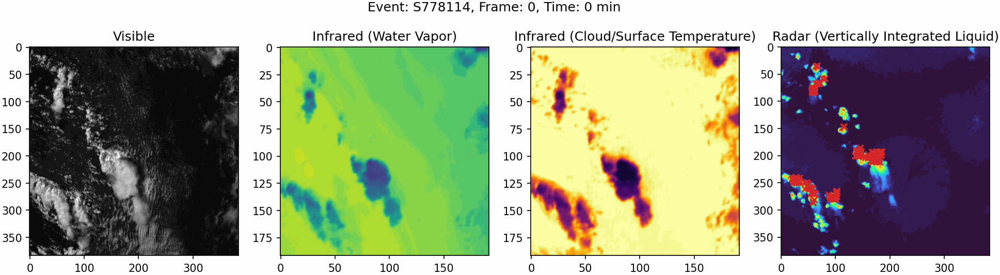

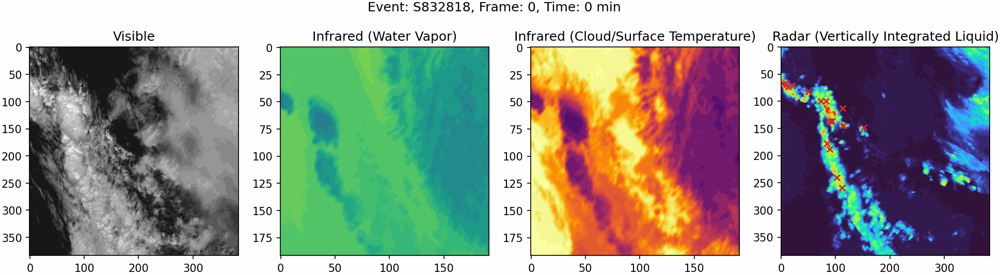

In [ ]:
# these functions will plot an event

def make_gif(outfile, files, fps=10, loop=0):
    "Helper function for saving GIFs"
    imgs = [PIL.Image.open(file) for file in files]
    imgs[0].save(fp=outfile, format='gif', append_images=imgs[1:],
                 save_all=True, duration=int(1000/fps), loop=loop)
    im = IPython.display.Image(filename=outfile)
    im.reload()
    return im

def plot_event(id, output_gif=False, save_gif=False):
    "Helper function for plotting an event"
    event = load_event(id)
    t = event["lght"][:,0]# time of lightning strike (in seconds relative to first frame)
    def plot_frame(ti):
        f = (t >= ti*5*60 - 2.5*60) & (t < ti*5*60 + 2.5*60)# find which lightning strikes fall in current frame
        fig,axs = plt.subplots(1,4,figsize=(16,4))
        fig.suptitle(f"Event: {id}, Frame: {ti}, Time: {ti*5} min")
        axs[0].imshow(event["vis"][:,:,ti], vmin=0, vmax=10000, cmap="grey"), axs[0].set_title('Visible')
        axs[1].imshow(event["ir069"][:,:,ti], vmin=-8000, vmax=-1000, cmap="viridis"), axs[1].set_title('Infrared (Water Vapor)')
        axs[2].imshow(event["ir107"][:,:,ti], vmin=-7000, vmax=2000, cmap="inferno"), axs[2].set_title('Infrared (Cloud/Surface Temperature)')
        axs[3].imshow(event["vil"][:,:,ti], vmin=0, vmax=255, cmap="turbo"), axs[3].set_title('Radar (Vertically Integrated Liquid)')
        axs[3].scatter(event["lght"][f,3], event["lght"][f,4], marker="x", s=30, c="tab:red")
        axs[3].set_xlim(0,384), axs[3].set_ylim(384,0)
        if output_gif:
            file = f"_temp_{id}_{ti}.png"
            fig.savefig(file, bbox_inches="tight", dpi=150, pad_inches=0.02, facecolor="white")
            plt.close()
        else:
            plt.show()
    if output_gif:
        for ti in range(36): plot_frame(ti)
        im = make_gif(f"{id}.gif", [f"_temp_{id}_{ti}.png" for ti in range(36)])
        for ti in range(36): os.remove(f"_temp_{id}_{ti}.png")
        IPython.display.display(im)
        if not save_gif: os.remove(f"{id}.gif")
    else:
        plot_frame(0)
        plot_frame(17)
        plot_frame(34)

plot_event("S778114", output_gif=True, save_gif=True)
plot_event("S832818", output_gif=True, save_gif=True)

In [6]:
# Let's look at the lightning data for an event
pd.DataFrame(data=event["lght"], columns=["t", "lat (deg)", "lon (deg)", "vil pixel x", "vil pixel y"]).sort_values("t")

,t,lat (deg),lon (deg),vil pixel x,vil pixel y
0,0.0,35.221024,-91.398697,97.144623,277.964905
1,0.0,35.011932,-91.927162,50.720562,251.529099
2,0.0,35.162552,-91.867744,55.068687,268.602295
3,0.0,34.954666,-92.266518,20.261250,243.241348
4,1.0,33.350700,-91.901527,64.372375,67.255501
...,...,...,...,...,...
38772,10789.0,34.324982,-91.087601,132.307999,180.527847
38771,10789.0,33.844326,-89.936607,241.919693,135.542786
38770,10789.0,34.804821,-90.910904,144.651932,234.979279
38776,10799.0,33.544811,-91.005325,145.910568,94.501938


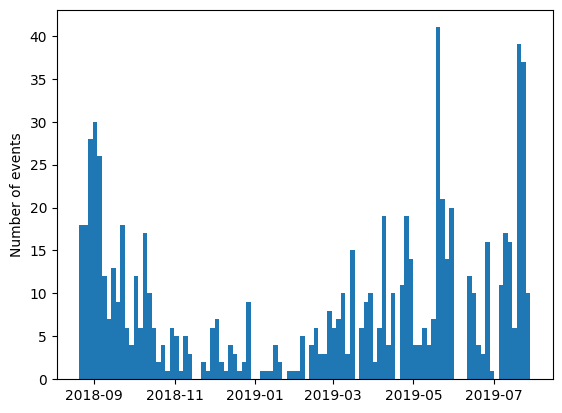

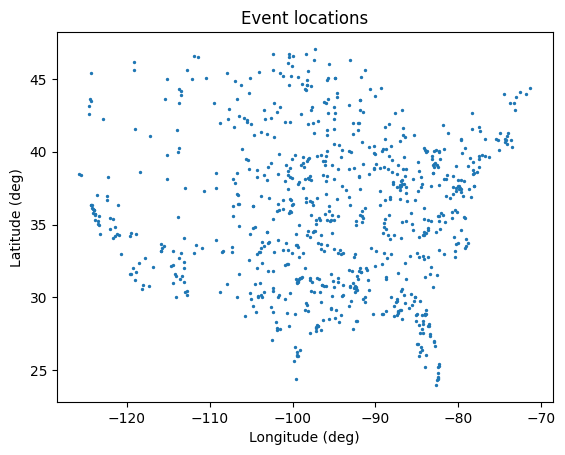

In [7]:
# let's plot some meta data histograms!

# plot times
plt.hist(df[df.img_type=="vil"].start_utc.dt.tz_localize(None), bins=100)
plt.ylabel("Number of events")
plt.show()

# plot positions
plt.title("Event locations")
plt.scatter(df[df.img_type=="vil"].llcrnrlon, df[df.img_type=="vil"].llcrnrlat, s=2)
plt.xlabel("Longitude (deg)"); plt.ylabel("Latitude (deg)")
plt.show()

## Parameter Settings

- **Min-max normalization**  
  To scale the data to the $[0, 1]$ range, we need global min and max values for each data channel. You can update these variables according to your computed or observed values.  
  For instance:  
  - **VIS** maximum: `global_vis_max· = 12896  
  - **IR069** range: $[-8472, -792]$  
  - **IR107** range: $[-8467, 5313]$

- **Number of events**  
  The variable `num` indicates how many storms (events) will be used for training or analysis. For example, if `num = 60`, it means we randomly choose 60 events from the dataset. You can adjust `num` to control your training set size or testing scope.



In [8]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
import h5py
import pandas as pd
import random
from scipy.ndimage import zoom
import torch.nn as nn
import torch.optim as optim

# Global max/min values for min-max normalization
global_vis_max = 12896
global_ir069_max, global_ir069_min = -792, -8472
global_ir107_max, global_ir107_min = 5313, -8467

# Number of events to use for training or analysis
num = 600

## Funciont of getting event ids

>To avoid overlap between training and test data, we select test data by different event IDs, rather than splitting a single event’s time steps across both sets.


>If some time steps from the same event are used for training, the model can inadvertently “memorize” event-specific patterns and produce artificially high accuracy on the remaining time steps of that same event. By ensuring the test set is comprised of distinct events entirely, we obtain a more realistic estimate of how well the model will generalize to unseen storms.

In [9]:
def get_event_ids(num):
    """
    Randomly selects `num` unique event IDs from 'events.csv' and splits them
    into train/test sets (80%/20%). If `num` exceeds the total, it is capped
    at the maximum available.

    Args:
        num (int): Number of event IDs to sample.

    Returns:
        (list, list): Two lists of event IDs, the first (80%) for the main set
        and the second (20%) for testing.
    """
    df = pd.read_csv("data/events.csv", parse_dates=["start_utc"])
    unique_ids = df["id"].unique()

    # If 'num' exceeds the total number of available events, limit it
    if num > len(unique_ids):
        num = len(unique_ids)

    # Randomly select 'num' events (no repetition)
    sampled_ids = random.sample(list(unique_ids), num)

    # Split 20% of them into a test set, and the remaining 80% into event_ids
    test_ids = sampled_ids[:int(num*0.2)]
    event_ids = sampled_ids[int(num*0.2):]
    return event_ids, test_ids

event_ids, test_ids= get_event_ids(num)

print(len(event_ids))
print(len(test_ids))
print(event_ids)
print(test_ids)

480
120
['S799367', 'S812771', 'S824961', 'S778012', 'S815393', 'S786356', 'S828868', 'S784856', 'S820532', 'S845084', 'S783744', 'S798681', 'S807772', 'S817357', 'S783498', 'S788040', 'S782531', 'S801234', 'S831869', 'S798658', 'S785385', 'S808730', 'S805592', 'S838628', 'S827991', 'S828118', 'S824150', 'S776707', 'S793686', 'S779422', 'S808982', 'S793266', 'S821043', 'S815938', 'S820227', 'S844588', 'S820947', 'S830316', 'S790562', 'S844393', 'S819456', 'S788211', 'S796695', 'S838867', 'S780175', 'S822238', 'S843692', 'S777884', 'S829646', 'S836870', 'S843743', 'S785742', 'S786425', 'S801693', 'S797541', 'S779890', 'S827578', 'S805105', 'S775287', 'S799001', 'S843648', 'S813630', 'S802445', 'S798757', 'S818623', 'S839685', 'S786001', 'S781453', 'S843992', 'S796621', 'S780114', 'S778114', 'S841230', 'S829342', 'S833125', 'S780296', 'S817676', 'S816859', 'S789990', 'S786979', 'S819134', 'S769788', 'S816992', 'S815061', 'S833608', 'S815085', 'S781198', 'S844704', 'S843957', 'S778803', '

## Functions for Data Preprocessing

- **Resize function**  
  The resolutions of **IR069** / **IR107** (192×192) and **VIS** / **VIL** (384×384) differ. For consistent model input and output, we need to unify the resolution. Resizing ensures all data fits the same shape before training.

- **Normalization function**  
  The data distribution varies greatly across events, making it challenging to find a perfect normalization strategy. Since the model output ultimately ranges from 0 to 255, we apply min-max normalization so that values fall between 0 and 1, which is generally suitable for most neural network architectures.

 One additional note: we multiply the maximum and minimum by 0.85 to mitigate the effect of outliers or extreme values, which occur frequently in climate image data. While it’s not possible to eliminate all anomalies, this adjustment helps stabilize the normalization process.

- **Data frame function**  
  For Task 2, temporal relationships are less critical. As a result, we remove the time dimension by treating each time step as an independent sample—effectively converting (H,W,T) into T separate frames. Furthermore, to improve model generalization within limited computational resources, we choose to include more events but fewer time steps for each event.

In [10]:
def resize_to_384(image):
    """
    Rescales a 3D array so that the first two dimensions become 384x384
    while keeping the third dimension unchanged. This is done via
    `scipy.ndimage.zoom`.

    The function calculates zoom factors based on the image's current
    height/width and applies bilinear interpolation (order=1).

    Args:
        image (numpy.ndarray): A 3D array of shape (H, W, T) where
            H and W are spatial dimensions, and T is typically a time
            or channel dimension.

    Returns:
        numpy.ndarray: A 3D array resized to (384, 384, T).
    """
    zoom_factors = [384 / image.shape[0], 384 / image.shape[1], 1]
    return zoom(image, zoom_factors, order=1)

def normalize_event(event, global_vis_max = None,
                    global_ir069_max = None, global_ir069_min = None,
                    global_ir107_max = None, global_ir107_min = None):

    """
    Normalizes event data using min-max or max-based scaling.
    If global min/max are not provided, they are taken from the event itself.

    Args:
        event (dict): Contains 'vis', 'ir069', 'ir107', 'vil' arrays.
        global_vis_max (float): Max value for 'vis'. If None, use event's own max.
        global_ir069_max (float): Max value for 'ir069'. If None, use event's own max.
        global_ir069_min (float): Min value for 'ir069'. If None, use event's own min.
        global_ir107_max (float): Max value for 'ir107'. If None, use event's own max.
        global_ir107_min (float): Min value for 'ir107'. If None, use event's own min.

    Returns:
        dict: The same event dict with normalized arrays.

    """
    # Determine fallback values if needed
    if global_vis_max is None:
        global_vis_max = event['vis'].max()

    if global_ir069_max is None or global_ir069_min is None:
        global_ir069_max = event['ir069'].max()
        global_ir069_min = event['ir069'].min()

    if global_ir107_max is None or global_ir107_min is None:
        global_ir107_max = event['ir107'].max()
        global_ir107_min = event['ir107'].min()

    # Normalize
    event['vis'] = event['vis'] / global_vis_max * 0.85
    event['ir069'] = (event['ir069'] - global_ir069_min * 0.85) / (global_ir069_max * 0.85 - global_ir069_min * 0.85)
    event['ir107'] = (event['ir107'] - global_ir107_min * 0.85) / (global_ir107_max * 0.85 - global_ir107_min * 0.85)
    event['vil'] = event['vil'] / 255.0

    return event

def create_frame_based_dataset(event):
    """
    Extracts frames from the 3D arrays (vis, ir069, ir107, vil) at a stride of 5,
    returning frame-wise (X, Y) pairs.

    Specifically, we pick every 5th time index from [0, total_frames).
    For each selected time step t, three channels (vis, ir069, ir107)
    are stacked into one frame for X, while vil forms the corresponding Y.

    Args:
        event (dict):
            - 'vis', 'ir069', 'ir107': 3D arrays of shape (H, W, T)
            - 'vil': 3D array of shape (H, W, T)

    Returns:
        (numpy.ndarray, numpy.ndarray):
            X: shape (T', H, W, 3),
               where T' = total_frames // 5 (approximately)
            Y: shape (T', H, W),
               matching X in the time dimension
    """
    X, Y = [], []
    total_frames = event['vil'].shape[2]

    # Take every 5th frame
    for t in range(0, total_frames, 5):
        x = np.stack([
            event['vis'][:, :, t],
            event['ir069'][:, :, t],
            event['ir107'][:, :, t]
        ], axis=-1)
        y = event['vil'][:, :, t]
        X.append(x)
        Y.append(y)

    return np.array(X), np.array(Y)


def load_event_subset(event_ids, h5_path="data/train.h5"):
    """
    Loads selected events from the HDF5 file, applies resizing, normalization,
    and converts them into frame-based (X, Y) datasets.

    Args:
        event_ids (list): List of event IDs to load.
        h5_path (str): HDF5 file path with event data.

    Returns:
        (numpy.ndarray, numpy.ndarray):
            Concatenated X and Y arrays across all chosen events.
    """
    X, Y = [], []
    with h5py.File(h5_path, 'r') as f:
        for event_id in event_ids:
            # Extract arrays
            event = {key: f[event_id][key][:] for key in ['vis', 'ir069', 'ir107', 'vil']}

            # Resize certain channels to 384×384
            event['ir069'] = resize_to_384(event['ir069'])
            event['ir107'] = resize_to_384(event['ir107'])

            # # Normalize all channels
            event = normalize_event(event, global_vis_max = global_vis_max,
                    global_ir069_max = global_ir069_max, global_ir069_min = global_ir069_min,
                    global_ir107_max = global_ir107_max, global_ir107_min = global_ir107_min)

            # Convert to frame-based (X, Y)
            x_event, y_event = create_frame_based_dataset(event)
            X.append(x_event)
            Y.append(y_event)

    # Concatenate across all events
    return np.concatenate(X, axis=0), np.concatenate(Y, axis=0)

X, Y = load_event_subset(event_ids)
X_test, Y_test = load_event_subset(test_ids)

print("Subset Input Shape:", X.shape)
print("Subset Output Shape:", Y.shape)

print("Test Input Shape:", X_test.shape)
print("Test Output Shape:", Y_test.shape)

Subset Input Shape: (3840, 384, 384, 3)
Subset Output Shape: (3840, 384, 384)
Test Input Shape: (960, 384, 384, 3)
Test Output Shape: (960, 384, 384)


In [11]:
from sklearn.model_selection import train_test_split

# Split the data: 80% train data set and 20% validation data set.
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.2, random_state=42)

print("Training set:", X_train.shape, Y_train.shape)
print("Validation set:", X_val.shape, Y_val.shape)

Training set: (3072, 384, 384, 3) (3072, 384, 384)
Validation set: (768, 384, 384, 3) (768, 384, 384)


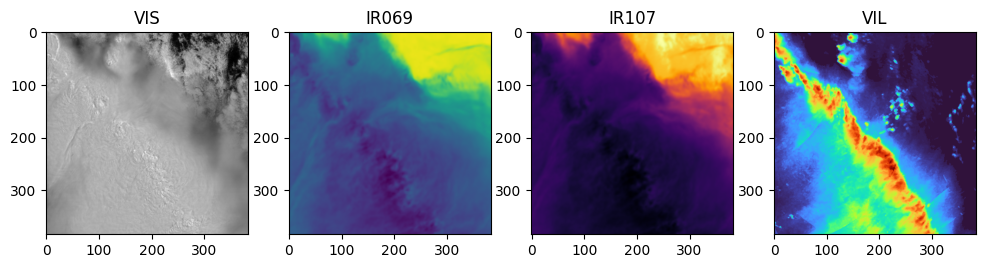

In [12]:
import matplotlib.pyplot as plt

def visualize_sample(X, Y, idx):

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 4, 1)
    plt.imshow(X[idx, :, :, 0], cmap='gray')  # VIS
    plt.title("VIS")
    plt.subplot(1, 4, 2)
    plt.imshow(X[idx, :, :, 1], cmap='viridis')  # IR069
    plt.title("IR069")
    plt.subplot(1, 4, 3)
    plt.imshow(X[idx, :, :, 2], cmap='inferno')  # IR107
    plt.title("IR107")
    plt.subplot(1, 4, 4)
    plt.imshow(Y[idx], cmap='turbo')  # VIL
    plt.title("VIL")
    plt.show()

# Visualization
visualize_sample(X_train, Y_train, idx=0)

In [13]:
import torch
from torch.utils.data import TensorDataset, DataLoader

def create_dataloaders(
    X_train, Y_train,
    X_val, Y_val,
    train_batch_size=16,
    val_batch_size=16,
    shuffle=True
):
    """
    Converts (X_train, Y_train, X_val, Y_val) into PyTorch tensors,
    rearranges dimensions, and packages them into DataLoaders for
    training and validation.

    Args:
        X_train, Y_train, X_val, Y_val (numpy.ndarray):
            - X_* shape: (N, H, W, C), where N is the number of samples
            - Y_* shape: (N, H, W)
        train_batch_size (int): Batch size for the training DataLoader.
        val_batch_size (int): Batch size for the validation DataLoader.
        shuffle (bool): Whether to shuffle the training set.

    Returns:
        (DataLoader, DataLoader): The training and validation DataLoaders.

    """

    # 1) Convert to PyTorch tensors and adjust dimensions
    #    X: (batch, channel, height, width) => permute(0, 3, 1, 2)
    #    Y: (batch, 1, height, width) => unsqueeze(1)
    X_train_t = torch.tensor(X_train, dtype=torch.float32).permute(0, 3, 1, 2)
    Y_train_t = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1)
    X_val_t   = torch.tensor(X_val,   dtype=torch.float32).permute(0, 3, 1, 2)
    Y_val_t   = torch.tensor(Y_val,   dtype=torch.float32).unsqueeze(1)

    # 2) Create TensorDataset objects
    train_dataset = TensorDataset(X_train_t, Y_train_t)
    val_dataset   = TensorDataset(X_val_t,   Y_val_t)

    # 3) Wrap them with DataLoader
    train_loader = DataLoader(
        train_dataset,
        batch_size=train_batch_size,
        shuffle=shuffle
    )
    val_loader = DataLoader(
        val_dataset,
        batch_size=val_batch_size,
        shuffle=False
    )

    return train_loader, val_loader


In [14]:
train_loader, val_loader = create_dataloaders(X_train, Y_train, X_val, Y_val)

## Baseline Model -- CNN

>This section presents a simple convolutional baseline. We use an encoder-decoder structure with transposed convolutions to upsample. Despite lacking skip connections, this CNN can serve as a baseline to compare with more sophisticated architectures.



EnhancedCNNModel(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (decoder): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (1): BatchNorm2d(

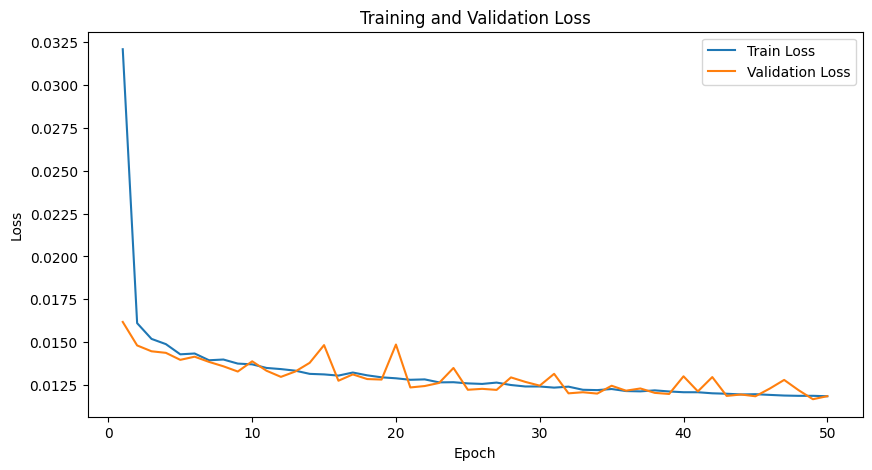

In [16]:
# Define a straightforward encoder-decoder CNN
class EnhancedCNNModel(nn.Module):
    def __init__(self):
        super(EnhancedCNNModel, self).__init__()
        # --- Encoder (downsampling) ---
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )

        # --- Decoder (upsampling) ---
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.ConvTranspose2d(64, 1, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Encode (downsample)
        x = self.encoder(x)

        # Decode (upsample)
        x = self.decoder(x)
        return x

# Instantiate the baseline CNN model
model = EnhancedCNNModel()
print(model)

# Define loss (MSE) and optimizer (Adam)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.0005)

# Training setup
num_epochs = 50
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

train_losses = []
val_losses = []

for epoch in range(num_epochs):
    # --- Training loop ---
    model.train()
    train_loss = 0
    for X_batch, Y_batch in train_loader:
        X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)

        optimizer.zero_grad()
        outputs = model(X_batch)
        loss = criterion(outputs, Y_batch)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    train_loss /= len(train_loader)
    train_losses.append(train_loss)

    # --- Validation loop ---
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for X_batch, Y_batch in val_loader:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
            outputs = model(X_batch)
            loss = criterion(outputs, Y_batch)
            val_loss += loss.item()
    val_loss /= len(val_loader)
    val_losses.append(val_loss)

    print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")

# Plot training and validation loss

plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epochs + 1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs + 1), val_losses, label="Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.title("Training and Validation Loss")
plt.show()

## Visualization of CNN Prediction on test data

During model training, our data (including VIS and VIL images) was normalized to a `[0,1]` range to stabilize learning. After the network produces its final predictions, we can **denormalize** these outputs to restore them back to their original scale (e.g., 0–255 for VIL). This helps us:

1. **Compare predictions to ground-truth** on the same range.
2. **Interpret the results** in a domain-specific context (e.g., meteorological values).

Below, we take a few samples from the test set, run inference through our trained CNN model, and then multiply by the known maximum values. Finally, we plot the **original VIS**, the **ground-truth VIL**, and the **model-predicted VIL** side by side. This provides a clear visual assessment of how closely our predictions match the actual data.


Test Loss: 0.0141 | Train Loss (last epoch): 0.0119 | Val Loss (last epoch): 0.0119


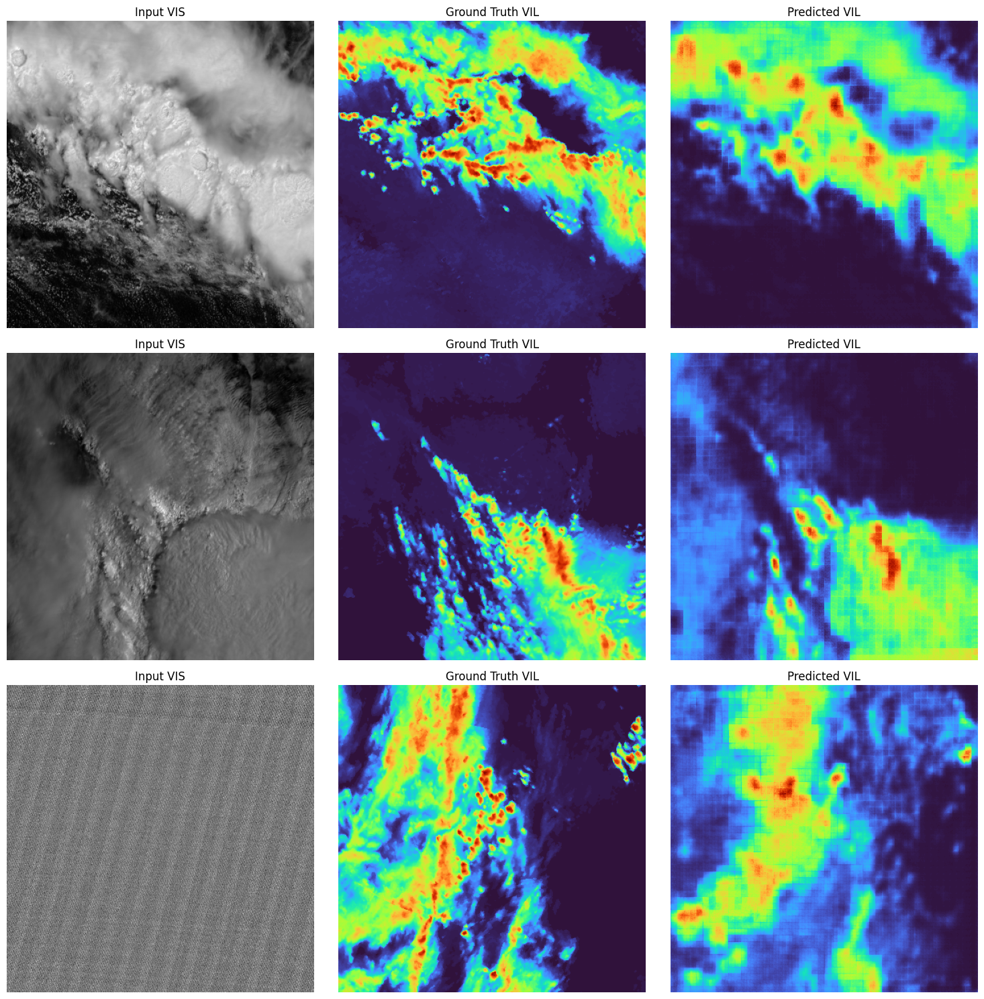

In [19]:
# Utility functions for "denormalization"
def denormalize_vis(vis, global_vis_max):
    """
    Converts VIS data back to its original scale by multiplying
    with the stored global maximum.
    """
    return vis * global_vis_max

def denormalize_vil(vil, global_vil_max):
    """
    Converts VIL data back to its original 0–255 range by multiplying
    with the specified global maximum.
    """
    return vil * global_vil_max

# Helper to pick valid sample indices (random selection)
def get_test_sample_idx(data, max_samples=3):
    """
    Randomly selects up to 'max_samples' indices from 'data'
    without repetition.
    """
    return np.random.choice(len(data), max_samples, replace=False)

# --- Evaluate on the entire test set to compute average test loss ---
model.eval()

X_test_t = torch.tensor(X_test, dtype=torch.float32).permute(0, 3, 1, 2).to(device)
Y_test_t = torch.tensor(Y_test, dtype=torch.float32).unsqueeze(1).to(device)

test_loss = 0.0

with torch.no_grad():
    for i in range(len(X_test_t)):
        # Single sample
        input_sample = X_test_t[i].unsqueeze(0)
        prediction = model(input_sample)

        # Ground-truth for the same sample
        gt_sample = Y_test_t[i].unsqueeze(0)

        # Compute MSE in normalized space ([0,1])
        loss_value = criterion(prediction, gt_sample)
        test_loss += loss_value.item()

test_loss /= len(X_test_t)

# Compare test loss with final training/validation losses
print(f"Test Loss: {test_loss:.4f} | "
      f"Train Loss (last epoch): {train_losses[-1]:.4f} | "
      f"Val Loss (last epoch): {val_losses[-1]:.4f}")


# --- Now visualize a few denormalized samples ---
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

# Randomly pick 3 valid indices from X_test for visualization
model.eval()
test_indices = get_test_sample_idx(X_test)  # e.g., up to 3 samples

for i, sample_idx in enumerate(test_indices):
    # Prepare a single sample for inference (on CPU for plotting convenience)
    input_sample = X_test_t[sample_idx].unsqueeze(0)
    prediction = model(input_sample).squeeze().cpu().detach().numpy()
    ground_truth = Y_test_t[sample_idx].squeeze().cpu().numpy()
    input_vis = X_test_t[sample_idx, 0].cpu().numpy()

    # Denormalize
    input_vis = denormalize_vis(input_vis, global_vis_max=12896)
    ground_truth = denormalize_vil(ground_truth, global_vil_max=255.0)
    prediction = denormalize_vil(prediction, global_vil_max=255.0)

    # Plot: VIS input, ground-truth VIL, and predicted VIL
    axes[i, 0].imshow(input_vis, cmap="gray")
    axes[i, 0].set_title("Input VIS")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(ground_truth, cmap="turbo")
    axes[i, 1].set_title("Ground Truth VIL")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(prediction, cmap="turbo")
    axes[i, 2].set_title("Predicted VIL")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()

In [21]:
# Store the CNN model in Google Drive
from google.colab import drive
drive.mount('/content/drive')

save_path = '/content/drive/My Drive/cnn_model.pth'
torch.save(model.state_dict(), save_path)
print(f"Model saved to {save_path}")

Mounted at /content/drive
Model saved to /content/drive/My Drive/cnn_model.pth


## Analysis of CNN Prediction

From the visualization results, we can note several important observations:

1. **Striped Shadows in VIS**  
   Occasionally, the input VIS images show linear or strip-shaped artifacts. One likely cause is the **normalization** procedure. Since the model ultimately outputs data in a 0–255 range, min-max or similar normalization schemes are typically used. However, because of the significant variation in the data distribution, these methods cannot perfectly accommodate every sample. In images whose pixel intensity distributions are either extremely high or extremely low compared to the norm, these strip shadows become visible.

2. **Overall Prediction Quality**  
   Despite some imperfections, the predicted VIL maps capture the general shapes, color gradients, and storm-tail structures reasonably well. Although it is not entirely accurate for every pixel, the model still provides useful insights for the task at hand, such as identifying where major convective regions or precipitation cores might be.

3. **Grid-Like Patterns**  
   In certain predicted outputs, a blocky or grid-like structure is noticeable. A direct cause of this effect is often **max pooling** and **ConvTranspose2d**, which reduces spatial resolution while attempting to capture key features. As a result, the model can have difficulty restoring high-resolution details during the decoding phase. One way to mitigate this is by using **skip connections** or residual paths—techniques exemplified by **U-Net**—which preserve higher-resolution features from earlier encoder layers and help reconstruct finer details in the output.


## Better Model -- U-Net Model

>Below is a U-Net architecture designed to improve upon the simpler CNN baseline. Unlike a standard encoder‐decoder, U-Net introduces **skip connections** to merge downsampled features with higher-resolution layers during upsampling. This helps the model retain spatial detail more effectively.

>The final layer uses a sigmoid activation to constrain the output to $[0,1]$. If desired, you can multiply by 255 to map the prediction back to a 0–255 range.



In [20]:
class EarlyStopping:
    """
    Stops training when the validation loss does not improve after 'patience' epochs.
    Optionally, you can restore model weights from the epoch with the best loss.
    """
    def __init__(self, patience=5, min_delta=0.0, restore_best_weights=False):
        self.patience = patience
        self.min_delta = min_delta
        self.restore_best_weights = restore_best_weights
        self.best_loss = float('inf')
        self.best_state = None
        self.counter = 0
        self.early_stop = False

    def __call__(self, val_loss, model):
        # Check if the validation loss improved enough
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
            if self.restore_best_weights:
                # Save the current best model weights
                self.best_state = {k: v.cpu() for k, v in model.state_dict().items()}
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

    def load_best_weights(self, model):
        if self.best_state is not None:
            model.load_state_dict(self.best_state)

UNet(
  (encoder1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (encoder2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (encoder3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=T

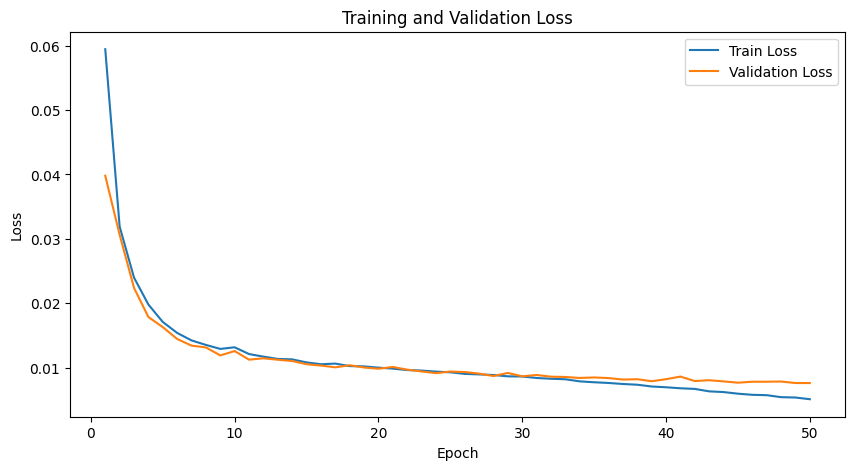

In [22]:
# Deine U-Net Model
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # --- Encoder layers (downsampling) ---
        self.encoder1 = self.conv_block(3, 64)
        self.encoder2 = self.conv_block(64, 128)
        self.encoder3 = self.conv_block(128, 256)
        self.encoder4 = self.conv_block(256, 512)

        # Pooling reduces spatial dimensions
        self.pool = nn.MaxPool2d(2)

        # Bottleneck acts as the deepest layer
        self.bottleneck = self.conv_block(512, 1024)

        # --- Decoder layers (upsampling) ---
        # Each upconv doubles resolution, then skip-connection merges with encoder output
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = self.conv_block(1024, 512)
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = self.conv_block(512, 256)
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = self.conv_block(256, 128)
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = self.conv_block(128, 64)

        # Final 1×1 conv for single-channel output
        self.final = nn.Conv2d(64, 1, kernel_size=1)
        # Sigmoid activation to map output to [0,1]，which can transform to 0 - 255 by multiplicating 255.
        self.sigmoid = nn.Sigmoid()

    def conv_block(self, in_channels, out_channels):
        """
        A helper function creating two (Conv + BN + ReLU) layers.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # --- Encoding path ---
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool(enc1))
        enc3 = self.encoder3(self.pool(enc2))
        enc4 = self.encoder4(self.pool(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool(enc4))

        # --- Decoding path with skip connections ---
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)

        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)

        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        # Final 1-channel output with sigmoid
        return self.sigmoid(self.final(dec1))

# Instantiate the model
model = UNet()
print(model)

# Define loss function (MSE) and optimizer (Adam)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

# Training settings
num_epochs = 50
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

train_losses = []
val_losses = []

# Instantiate EarlyStopping
early_stopping = EarlyStopping(patience=5, min_delta=0.0, restore_best_weights=True)

for epoch in range(num_epochs):
    # --- Training loop ---
    model.train()
    train_loss = 0
    for X_batch, Y_batch in train_loader:

        # Move data to GPU/CPU
        X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)

        # Reset gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model(X_batch)

        # Compute loss
        loss = criterion(outputs, Y_batch)

        # Backprop and update weights
        loss.backward()

        optimizer.step()
        train_loss += loss.item()

    train_loss /= len(train_loader)
    train_losses.append(train_loss)

    # --- Validation loop ---
    model.eval()
    val_loss = 0
    with torch.no_grad():
        for X_batch, Y_batch in val_loader:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
            outputs = model(X_batch)
            loss = criterion(outputs, Y_batch)
            val_loss += loss.item()

    val_loss /= len(val_loader)
    val_losses.append(val_loss)

    print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")

    # Check early stopping condition
    early_stopping(val_loss, model)
    if early_stopping.early_stop:
        print("Early stopping triggered!")
        break

# If restore_best_weights is True, load the best model state
# (where validation loss was lowest).
if early_stopping.restore_best_weights and early_stopping.best_state is not None:
    early_stopping.load_best_weights(model)
    print("Model weights restored to best validation state.")

# Plot training and validation loss curves
epochs = range(1, len(train_losses) + 1)
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_losses, label="Train Loss")
plt.plot(epochs, val_losses, label="Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.title("Training and Validation Loss")
plt.show()

# Store the result regularly
if epoch % 10 == 0:  # every 10 epoch
    model.eval()
    with torch.no_grad():
        X_sample = next(iter(val_loader))[0].to(device)
        Y_sample = model(X_sample).cpu().numpy()
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(X_sample[0, 0].cpu(), cmap='gray')
        plt.title("Input VIS")
        plt.subplot(1, 3, 2)
        plt.imshow(Y_sample[0, 0], cmap='turbo')
        plt.title("Predicted VIL")
        plt.show()

## Visualization of U-Net Prediction on test data

>As previously mentioned, we use test data drawn from entirely different event IDs to evaluate the model’s predictive performance.

Test Loss: 0.0113 | Train Loss (last epoch): 0.0051 | Val Loss (last epoch): 0.0076


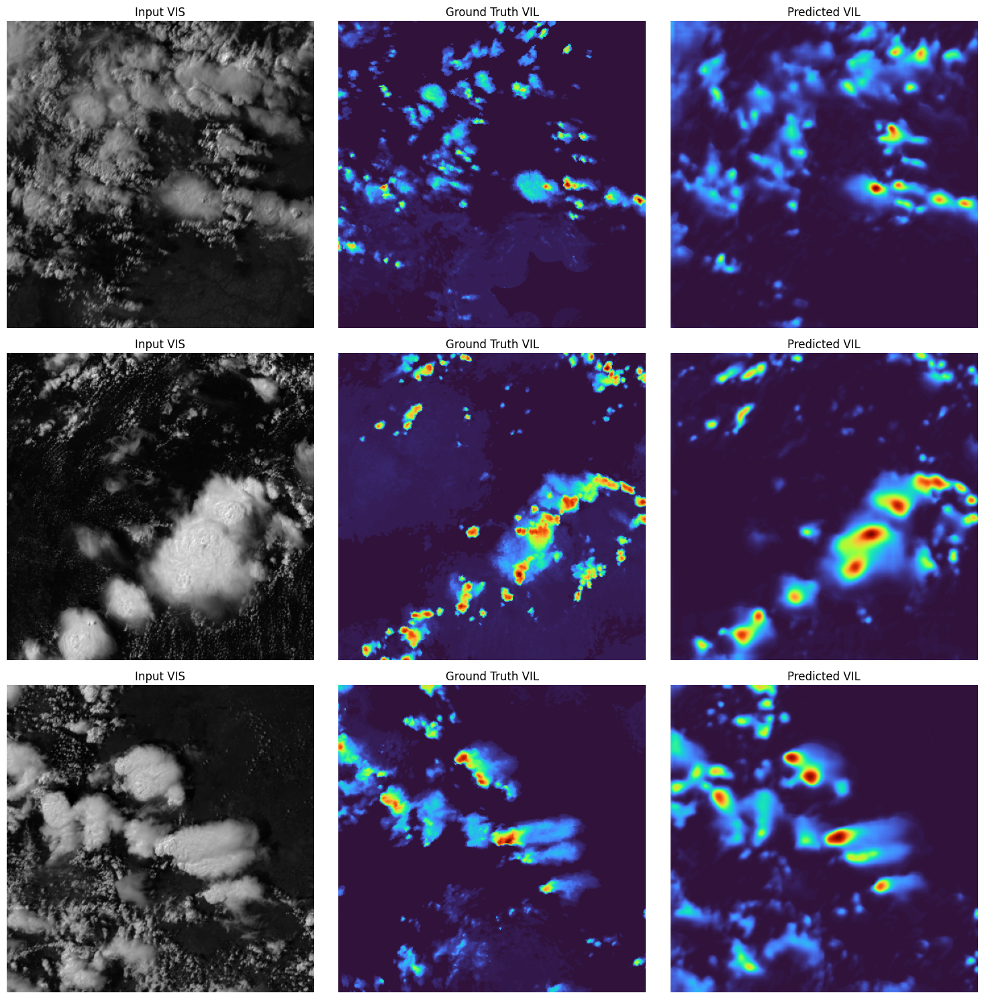

In [24]:
# --- Evaluate on the entire test set to compute average test loss ---
model.eval()

test_loss = 0.0

with torch.no_grad():
    for i in range(len(X_test_t)):
        # Single sample
        input_sample = X_test_t[i].unsqueeze(0)
        prediction = model(input_sample)

        # Ground-truth for the same sample
        gt_sample = Y_test_t[i].unsqueeze(0)

        # Compute MSE in normalized space ([0,1])
        loss_value = criterion(prediction, gt_sample)
        test_loss += loss_value.item()

test_loss /= len(X_test_t)

# Compare test loss with final training/validation losses
print(f"Test Loss: {test_loss:.4f} | "
      f"Train Loss (last epoch): {train_losses[-1]:.4f} | "
      f"Val Loss (last epoch): {val_losses[-1]:.4f}")


# --- Now visualize a few denormalized samples ---
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

# Randomly pick 3 valid indices from X_test for visualization
model.eval()
test_indices = get_test_sample_idx(X_test)  # e.g., up to 3 samples

for i, sample_idx in enumerate(test_indices):
    # Prepare a single sample for inference (on CPU for plotting convenience)
    input_sample = X_test_t[sample_idx].unsqueeze(0)
    prediction = model(input_sample).squeeze().cpu().detach().numpy()
    ground_truth = Y_test_t[sample_idx].squeeze().cpu().numpy()
    input_vis = X_test_t[sample_idx, 0].cpu().numpy()

    # Denormalize
    input_vis = denormalize_vis(input_vis, global_vis_max=12896)
    ground_truth = denormalize_vil(ground_truth, global_vil_max=255.0)
    prediction = denormalize_vil(prediction, global_vil_max=255.0)

    # Plot: VIS input, ground-truth VIL, and predicted VIL
    axes[i, 0].imshow(input_vis, cmap="gray")
    axes[i, 0].set_title("Input VIS")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(ground_truth, cmap="turbo")
    axes[i, 1].set_title("Ground Truth VIL")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(prediction, cmap="turbo")
    axes[i, 2].set_title("Predicted VIL")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


In [25]:
# Store the U-Net model in Google Drive

save_path = '/content/drive/My Drive/unet_model.pth'
torch.save(model.state_dict(), save_path)
print(f"Model saved to {save_path}")

Model saved to /content/drive/My Drive/unet_model.pth


## Analysis of U-Net Prediction

> We tried various approaches when training our U-Net model. Initially, we used **all 36 time steps** for each event as part of the training data, but this introduced considerable redundancy. Moreover, we applied the train/validation split **after** unfolding all time steps and merging them, causing many identical or near-identical frames to appear in both the training and validation sets. This severely hindered the model’s ability to generalize.

> Although the training and validation losses dropped as low as ~0.003, a random check on **completely different** event IDs revealed clear overfitting: the test loss was several times higher than the validation loss. To address this, we restructured the dataset—selecting **more events** overall, but only **partial time steps** from each event. This helped reduce repetition and improve the model’s generalization.

> From the visual results, the U-Net predictions are slightly more accurate and often smoother than those from the basic CNN, though both models still show room for improvement.

------